<a href="https://colab.research.google.com/github/ferit-ml/lv6-leo-tumbas/blob/main/RUSU_LV6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Nenadzirano učenje

Nenadzirano učenje je vrsta strojnog učenja gdje je cilj istražiti strukturu dostupnih podataka kako bi izvukli važne informacije (npr. otkriti nekakva interesantna svojstva). Pri tome je raspoloživi skup podataka neoznačen (znači nećemo imati vrijednosti odgovarajuće izlazne veličine) i ne postoji sustav nagrađivanja tijekom učenja kao kod podržanog učenja.

Dva česta problema u nenadziranom učenju su grupiranje podataka i smanjivanje dimenzionalnosti i rekonstrukcija. U ovoj laboratorijskoj vježbi ćemo se baviti drugim problemom, smanjivanjem dimenzionalnosti i rekonstrukcijom. Za ovo ćemo koristiti autoenkodere.

## Autoenkoderi

Autoenkoderi su vrsta neuronskih mreža koje se koriste za učenje efikasnih reprezentacija podataka, a imaju široku primjenu u područjima poput kompresije podataka, generiranja slika i detekcije anomalija.

Autoenkoderi se sastoje od dvije osnovne komponente - enkodera i dekodera. Enkoder prima ulazni primjer i preslikava ga u kompaktni vektor (vektor niže dimenzije od ulaznog primjera). Dekoder zatim koristi taj vektor kako bi rekonstruirao originalni ulaz.

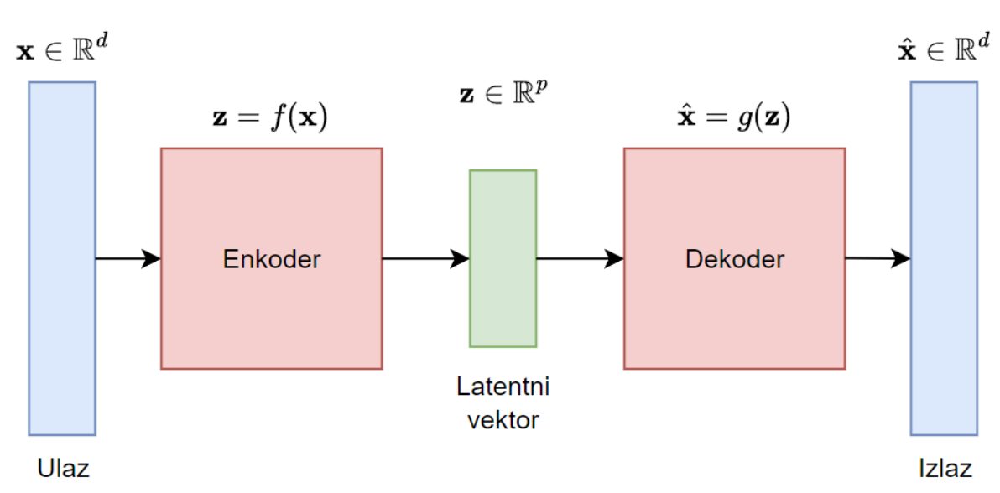

### Konvolucijski autoenkoder

Konvolucijski autoenkoderi koriste operacije konvolucije i [transponirane konvolucije](https://pytorch.org/docs/stable/generated/torch.nn.ConvTranspose2d.html). U enkoderu je cilj smanjiti dimenzionalnost. Ovo se može postići na dva načina:
 - Korištenjem slojeva sažimanja za smanjenje dimenzionalnosti nakon konvolucijskih slojeva
 - Korištenjem *stridea* većeg od 1 u konvolucijskim slojevima, čime se također smanje dimenzije izlaznih matrica


 Postoje dva česta pristupa rekonstrukciji slike u dekoderu:
  - Korištenjem tzv. *upsampling* slojeva popraćenih standardnim konvolucijskim slojevima
  - Korištenjem transponirante konvolucije za povećanje dimenzionalnosti

  
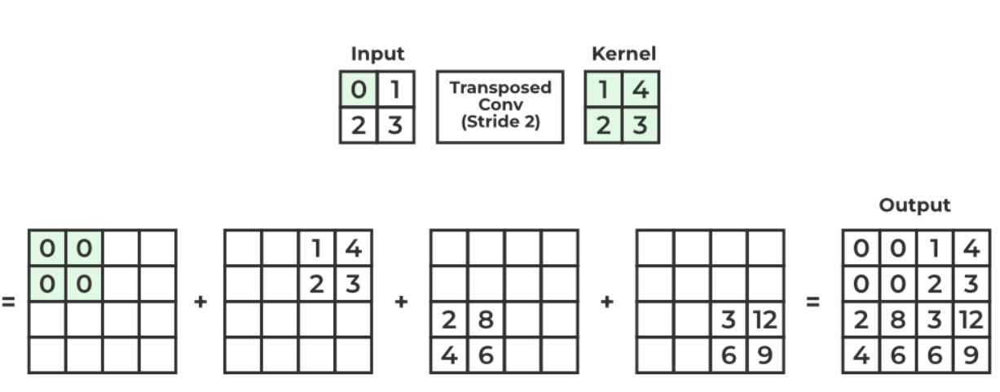

Dimenzije izlazne matrice iz konvolucije:
$$n_{out} = \frac{n_{in} + 2p - k}{s} + 1$$

Dimenzije izlazne matrice kod transponirane konvolucije:
$$n_{out} = s(n_{in} - 1) + k - 2p$$

Gdje su:
 - $n_{out}$ - dimenzija izlazne matrice
 - $n_{in}$ - dimenzija ulazne matrice
 - $k$ - dimenzija kernela
 - $s$ - *stride*
 - $p$ - *padding*

## Zadaci

1. Izradite konvolucijski autoenkoder sa sheme te ga istrenirajte na podatkovnom skupu [MNIST](https://pytorch.org/vision/stable/generated/torchvision.datasets.MNIST.html). Koristite BCELoss za funkciju gubitka. Brojevi na shemi prikazuju dimenzije izlazne matrice iz svakog pojedinog sloja, prvi broj predstavlja broj kanala. Istestirajte vaš autoenkoder i prikažite primjere parova ulaznih i izlanih slika.

2. Prilikom treniranja i testiranja dodajte normalan (Gaussov) šum na ulazne slike iz MNIST podatkovnog skupa. Vaš autoenkoder treba rekonstruirati slike bez dodanog šuma. Po potrebi prilagodite strukturu mreže. Isprobajte razne parametre šuma.

3. Izradite proizvoljan autoenkoder te ga istrenirajte na podatkovnom skupu [CelebA](https://mmlab.ie.cuhk.edu.hk/projects/CelebA.html). Upute za dohvaćanje podatkovnog skupa dane su u nastavku. Također je potrebno izraditi vlastitu *dataset* klasu za dani podatkovni skup.

Dodatno:

Zacrnite nasumične pravokutnike na ulaznim slikama iz 3. zadatka te istrenirajte autoenkoder za uklanjanje pravokutnika. Isprobajte s različitim veličinama pravokutnika.

#### Shema mreže za prvi zadatak.

Plavom bojom su prikazani izlazi iz pojedinih slojeva enkodera, narančastom bojom su prikazani izlazi iz pojedinih slojeva dekodera. *Kernel size* i *stride* za sve slojeve trebaju biti 4 i 2. *Padding* prilagodite ovisno o željenoj veličini izlaza. Svi konvolucijski slojevi popraćeni su ReLU aktivacijskom funkcijom osim posljednjeg sloja u dekoderu, on je popraćen sigmoid aktivacijskom funkcijom kako bi se dobio izlaz između 0 i 1, odnosno u istom formatu kao što su ulazne slike.


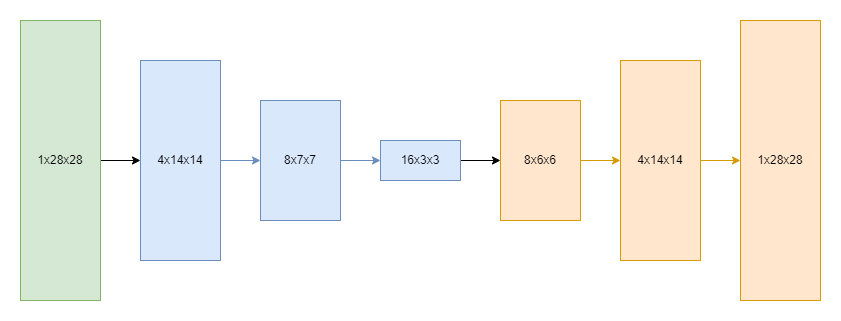

In [1]:
## Importing useful libraries
import os
import math
import numpy as np
import time
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data
import torchvision.transforms as transforms
import torchvision
from torchsummary import summary
import cv2 as cv
import random
import pandas as pd

import matplotlib.pyplot as plt
from imageio.v2 import imread
%matplotlib inline
%load_ext tensorboard

from tqdm.notebook import tqdm
from torch.utils.tensorboard import SummaryWriter

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print("Device", device)

Device cuda


In [ ]:
class Encoder(nn.Module):

    def __init__(self):
        super().__init__()
        self.relu = nn.ReLU()
        self.first_layer = nn.Conv2d(1, 4, 4, 2, 1)
        self.second_layer = nn.Conv2d(4, 8, 4, 2, 1)
        self.third_layer = nn.Conv2d(8, 16, 4, 2, 1)

    def forward(self, x):
        out = self.first_layer(x)
        out = self.relu(out)
        out = self.second_layer(out)
        out = self.relu(out)
        out = self.third_layer(out)
        out = self.relu(out)
        return out


class Decoder(nn.Module):

    def __init__(self):
        super().__init__()
        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()
        self.first_layer = nn.ConvTranspose2d(16, 8, 4, 2, 1)
        self.second_layer = nn.ConvTranspose2d(8, 4, 4, 2)
        self.third_layer = nn.ConvTranspose2d(4, 1, 4, 2, 1)

    def forward(self, x):
        out = self.first_layer(x)
        out = self.relu(out)
        out = self.second_layer(out)
        out = self.relu(out)
        out = self.third_layer(out)
        out = self.sigmoid(out)
        return out

class Autoencoder(nn.Module):

    def __init__(self):
        super().__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()

    def forward(self, x):
        latent = self.encoder(x)
        reconstruction = self.decoder(latent)
        return reconstruction

In [ ]:
transform = transforms.Compose([transforms.ToTensor()])
batch_size = 512

whole_trainset = torchvision.datasets.MNIST(root='/content/data/MNIST_Train/', train=True, download=True, transform = transform)
trainset, valset = torch.utils.data.random_split(whole_trainset, [48000, 12000])

trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, shuffle=True)
valloader = torch.utils.data.DataLoader(valset, batch_size=batch_size, shuffle=True)

testset = torchvision.datasets.MNIST(root='/content/data/MNIST_Test/', train=False, download=True, transform = transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size, shuffle=False)

100%|██████████| 9912422/9912422 [00:00<00:00, 91742967.95it/s]


Extracting /content/data/MNIST_Train/MNIST/raw/train-images-idx3-ubyte.gz to /content/data/MNIST_Train/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 6556026.08it/s]


Extracting /content/data/MNIST_Train/MNIST/raw/train-labels-idx1-ubyte.gz to /content/data/MNIST_Train/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 45447559.01it/s]


Extracting /content/data/MNIST_Train/MNIST/raw/t10k-images-idx3-ubyte.gz to /content/data/MNIST_Train/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 20288103.05it/s]

Extracting /content/data/MNIST_Train/MNIST/raw/t10k-labels-idx1-ubyte.gz to /content/data/MNIST_Train/MNIST/raw



100%|██████████| 9912422/9912422 [00:00<00:00, 169501680.70it/s]

Extracting /content/data/MNIST_Test/MNIST/raw/train-images-idx3-ubyte.gz to /content/data/MNIST_Test/MNIST/raw


100%|██████████| 28881/28881 [00:00<00:00, 62025444.87it/s]


Extracting /content/data/MNIST_Test/MNIST/raw/train-labels-idx1-ubyte.gz to /content/data/MNIST_Test/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 48392995.62it/s]

Extracting /content/data/MNIST_Test/MNIST/raw/t10k-images-idx3-ubyte.gz to /content/data/MNIST_Test/MNIST/raw


100%|██████████| 4542/4542 [00:00<00:00, 10398760.24it/s]

Extracting /content/data/MNIST_Test/MNIST/raw/t10k-labels-idx1-ubyte.gz to /content/data/MNIST_Test/MNIST/raw



In [ ]:
# Zadatak 1

def train_model_with_logger(model, optimizer, train_data_loader, val_data_loader, loss_module, num_epochs=100, logging_dir='runs/our_experiment', name='task_1'):
    # Set model to train mode
    writer = SummaryWriter(logging_dir)
    %tensorboard --logdir runs/our_experiment
    model.train()

    if os.path.exists('/content/' + name + '/') == False:
      os.mkdir('/content/' + name + '/')

    # Training loop
    for epoch in range(num_epochs):
        epoch_loss = 0.0
        for data_inputs, _ in tqdm(train_data_loader, 'Epoch %d'%(epoch + 1)):

            ## Step 1: Move input data to device
            data_inputs = data_inputs.to(device)

            ## Step 2: Run the model on the input data
            reconstructed = model(data_inputs)

            ## Step 3: Calculate the loss
            data_inputs = data_inputs.cpu()
            reconstructed = reconstructed.cpu()
            loss = loss_module(reconstructed, data_inputs)

            ## Step 4: Perform backpropagation
            optimizer.zero_grad()

            # Perform backpropagation
            loss.backward()

            ## Step 5: Update the parameters
            optimizer.step()

            epoch_loss += loss.item() * len(data_inputs)

        # Add average loss to TensorBoard
        epoch_loss /= len(train_data_loader.dataset)

        model.eval() # Set model to eval mode

        ## TODO
        ## Calculate loss for the whole dataset
        eval_loss = 0.0
        with torch.no_grad(): # Deactivate gradients for the following code
            for data_inputs, _ in val_data_loader:

                # Determine prediction of model on dev set
                data_inputs = data_inputs.to(device)
                reconstructed = model(data_inputs)

                loss = loss_module(reconstructed, data_inputs)
                eval_loss += loss.item() * len(data_inputs)

        eval_loss /= len(val_data_loader.dataset)
        writer.add_scalar('training_loss',
                          epoch_loss,
                          global_step = epoch + 1)
        writer.add_scalar('eval_loss',
                          eval_loss,
                          global_step = epoch + 1)

        state_dict = model.state_dict()
        torch.save(state_dict, "/content/" + name + "/model_" + name + '_' + str(epoch+1) + ".pt")
        model.train()

    writer.close()

In [ ]:
# Zadatak 1

model = Autoencoder()
model.to(device)

summary(model, (1, 28, 28))

In [ ]:
# Zadatak 1

loss_module = nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters(), weight_decay=0.001)

train_model_with_logger(model, optimizer, trainloader, valloader, loss_module)

In [ ]:
# Zadatak 2
# Generira Gaussov šum proizvoljnim mu i sigmom iz [0.25, 0.75]

class GaussianNoise(object):
  def __init__(self, mu):
    self.mu = mu

  def __call__(self, img):
    gauss = np.random.normal(self.mu, random.uniform(0.25, 0.75), img.shape).astype(np.float32)
    noisy_img = img + gauss
    noisy_img[noisy_img < 0] = 0
    noisy_img[noisy_img > 1] = 1
    return noisy_img

In [ ]:
# Zadatak 2

def noisy_train_model_with_logger(model, optimizer, train_data_loader, val_data_loader, loss_module, num_epochs=100, logging_dir='runs/our_experiment', name='task_2', noise=GaussianNoise(0)):
    # Set model to train mode
    writer = SummaryWriter(logging_dir)
    %tensorboard --logdir runs/our_experiment
    model.train()

    if os.path.exists('/content/' + name + '/') == False:
      os.mkdir('/content/' + name + '/')

    # Training loop
    for epoch in range(num_epochs):
        epoch_loss = 0.0
        for data_inputs, _ in tqdm(train_data_loader, 'Epoch %d'%(epoch + 1)):

            ## Step 1: Move input data to device
            noisy_data_inputs = noise(data_inputs).to(device)
            data_inputs = data_inputs.to(device)

            ## Step 2: Run the model on the input data
            reconstructed = model(noisy_data_inputs)

            ## Step 3: Calculate the loss
            loss = loss_module(reconstructed, data_inputs)

            ## Step 4: Perform backpropagation
            optimizer.zero_grad()

            # Perform backpropagation
            loss.backward()

            ## Step 5: Update the parameters
            optimizer.step()

            epoch_loss += loss.item() * len(data_inputs)

        # Add average loss to TensorBoard
        epoch_loss /= len(train_data_loader.dataset)

        model.eval() # Set model to eval mode

        ## TODO
        ## Calculate loss for the whole dataset
        eval_loss = 0.0
        with torch.no_grad(): # Deactivate gradients for the following code
            for data_inputs, _ in val_data_loader:

                # Determine prediction of model on dev set
                noisy_data_inputs = noise(data_inputs).to(device)
                reconstructed = model(noisy_data_inputs)
                data_inputs = data_inputs.to(device)

                loss = loss_module(reconstructed, data_inputs)
                eval_loss += loss.item() * len(data_inputs)

        eval_loss /= len(val_data_loader.dataset)
        writer.add_scalar('training_loss',
                          epoch_loss,
                          global_step = epoch + 1)
        writer.add_scalar('eval_loss',
                          eval_loss,
                          global_step = epoch + 1)

        state_dict = model.state_dict()
        torch.save(state_dict, "/content/" + name + "/model_" + name + '_' + str(epoch+1) + ".pt")
        model.train()

    writer.close()

In [ ]:
# Zadatak 2

model = Autoencoder()
model.to(device)

summary(model, (1, 28, 28))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 4, 14, 14]              68
              ReLU-2            [-1, 4, 14, 14]               0
            Conv2d-3              [-1, 8, 7, 7]             520
              ReLU-4              [-1, 8, 7, 7]               0
            Conv2d-5             [-1, 16, 3, 3]           2,064
              ReLU-6             [-1, 16, 3, 3]               0
           Encoder-7             [-1, 16, 3, 3]               0
   ConvTranspose2d-8              [-1, 8, 6, 6]           2,056
              ReLU-9              [-1, 8, 6, 6]               0
  ConvTranspose2d-10            [-1, 4, 14, 14]             516
             ReLU-11            [-1, 4, 14, 14]               0
  ConvTranspose2d-12            [-1, 1, 28, 28]              65
          Sigmoid-13            [-1, 1, 28, 28]               0
          Decoder-14            [-1, 1,

In [ ]:
# Zadatak 2

loss_module = nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters(), weight_decay=0.001)

noisy_train_model_with_logger(model, optimizer, trainloader, valloader, loss_module)

Reusing TensorBoard on port 6006 (pid 349), started 0:21:58 ago. (Use '!kill 349' to kill it.)

<IPython.core.display.Javascript object>

Epoch 1:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 2:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 3:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 4:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 5:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 6:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 7:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 8:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 9:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 10:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 11:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 12:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 13:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 14:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 15:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 16:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 17:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 18:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 19:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 20:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 21:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 22:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 23:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 24:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 25:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 26:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 27:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 28:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 29:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 30:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 31:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 32:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 33:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 34:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 35:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 36:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 37:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 38:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 39:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 40:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 41:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 42:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 43:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 44:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 45:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 46:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 47:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 48:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 49:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 50:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 51:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 52:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 53:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 54:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 55:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 56:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 57:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 58:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 59:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 60:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 61:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 62:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 63:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 64:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 65:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 66:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 67:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 68:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 69:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 70:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 71:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 72:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 73:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 74:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 75:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 76:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 77:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 78:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 79:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 80:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 81:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 82:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 83:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 84:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 85:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 86:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 87:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 88:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 89:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 90:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 91:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 92:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 93:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 94:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 95:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 96:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 97:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 98:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 99:   0%|          | 0/94 [00:00<?, ?it/s]

Epoch 100:   0%|          | 0/94 [00:00<?, ?it/s]

In [ ]:
# Zadatak 2

def test_model(model, testloader, noise=GaussianNoise(0)):
  test_mod = Autoencoder()
  test_mod.load_state_dict(torch.load('/content/task_2/' + model + '.pt'))
  test_mod = test_mod.to(device)
  test_mod.eval()

  batch = 0
  print(model)
  for data_inputs, _ in tqdm(testloader):

      # Determine prediction of model on dev set
      noisy_data_inputs = noise(data_inputs).to(device)
      reconstructed = test_mod(noisy_data_inputs)

      noisy_data_inputs = noisy_data_inputs.cpu().detach().numpy()
      reconstructed = reconstructed.cpu().detach().numpy()

      plt.subplot(1, 2, 1)
      plt.imshow(noisy_data_inputs[0][0], cmap='gray')
      plt.title('Noisy input')
      plt.subplot(1, 2, 2)
      plt.imshow(reconstructed[0][0], cmap='gray')
      plt.title('Output')
      plt.savefig('/content/test/' + model + '/compare_plot_' + str(batch) + '.png')
      plt.figure()

      batch += 1

model_task_2_25


  0%|          | 0/20 [00:00<?, ?it/s]

model_task_2_50


<ipython-input-14-cf0f4866c10b>:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


  0%|          | 0/20 [00:00<?, ?it/s]

model_task_2_75


  0%|          | 0/20 [00:00<?, ?it/s]

model_task_2_100


  0%|          | 0/20 [00:00<?, ?it/s]

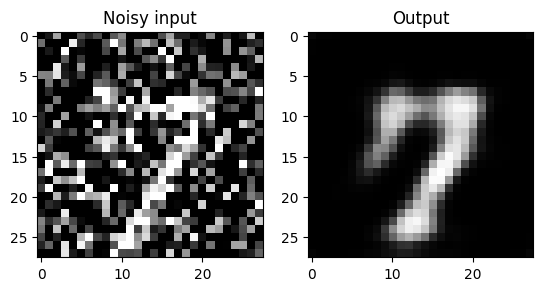

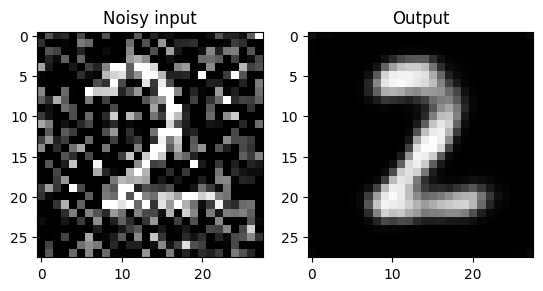

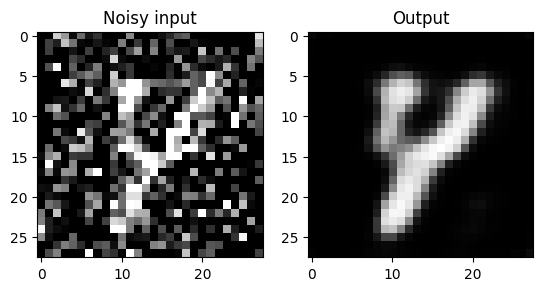

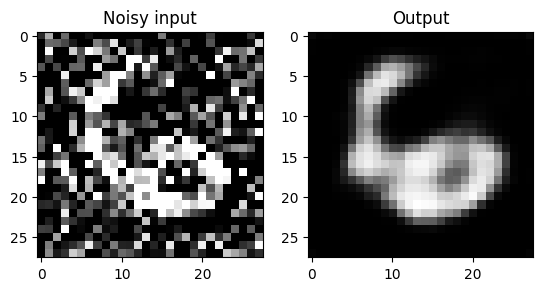

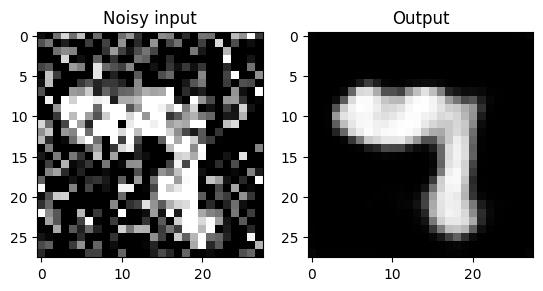

...

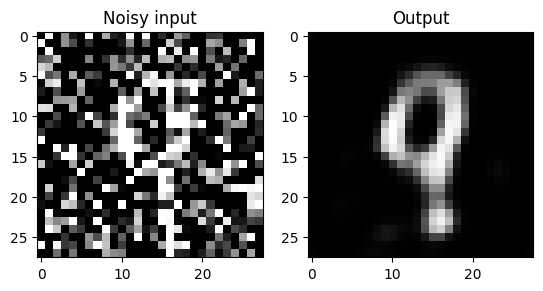

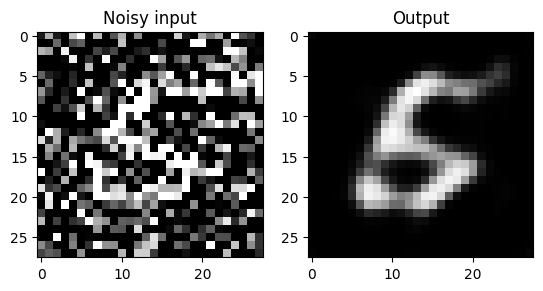

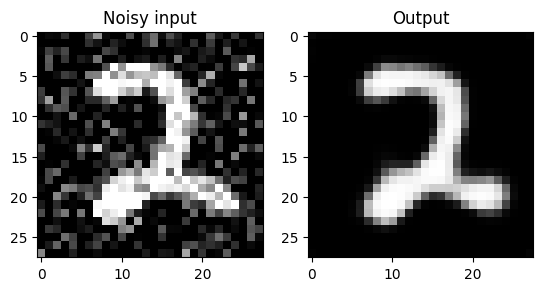

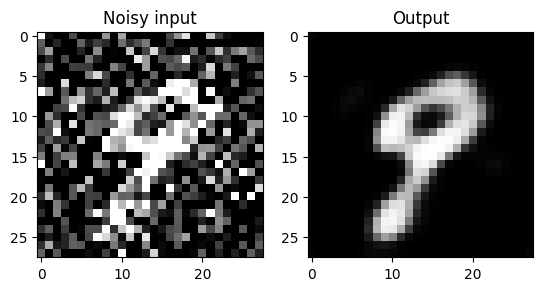

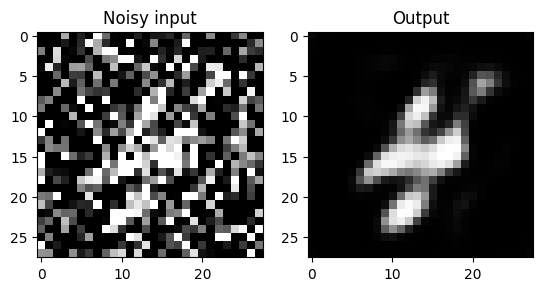

<Figure size 640x480 with 0 Axes>

In [ ]:
# Zadatak 2
# Testira modele nastale nakon 25, 50, 75, i 100 epoha
# Posprema prvi uzorak iz svakog batcha test dataseta u direktorij

if os.path.exists('/content/test/') == False:
  os.mkdir('/content/test/')

for m in ['25', '50', '75', '100']:
  if os.path.exists('/content/test/model_task_2_' + m) == False:
    os.mkdir('/content/test/model_task_2_' + m)
  test_model('model_task_2_' + m, testloader)

U nastavku slijede upute za rad s CelebA podatkovnog skupa. Pratite prva dva koraka prikazana [ovdje](https://www.kaggle.com/discussions/general/74235). Nakon toga `kaggle.json` datoteku stavite na svoj Google Drive. Preporučeno je staviti datoteku u root direktorij Google Drivea, ali možete ga staviti i na drugu lokaciju, ali onda trebate prilagoditi putanju u naredbi `! cp /content/drive/MyDrive/kaggle.json ~/.kaggle/`.

Ukoliko primijetite da vam izlazne slike imaju rešetke (*grid*) ili su nalik na šahovnicu, pokušajte izraditi autoenkoder pomoću *pooling* i *upsampling* slojeva, bez korištenja transponiranih konvolucija. Više o ovom problemu, pročitajte [ovdje](https://distill.pub/2016/deconv-checkerboard/).

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
! pip install -q kaggle
! mkdir ~/.kaggle
! cp /content/drive/MyDrive/kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list

ref                                                                 title                                             size  lastUpdated          downloadCount  voteCount  usabilityRating  
------------------------------------------------------------------  -----------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
thedrcat/daigt-v2-train-dataset                                     DAIGT V2 Train Dataset                            29MB  2023-11-16 01:38:36           1916        189  1.0              
muhammadbinimran/housing-price-prediction-data                      Housing Price Prediction Data                    763KB  2023-11-21 17:56:32           8530        149  1.0              
thedevastator/books-sales-and-ratings                               Books Sales and Ratings                           53KB  2023-12-06 04:54:33           1984         29  1.0              
thedrcat/daigt-proper-train-dataset                    

In [4]:
! kaggle datasets download jessicali9530/celeba-dataset

100% 1.33G/1.33G [01:02<00:00, 24.5MB/s]
100% 1.33G/1.33G [01:02<00:00, 22.7MB/s]


In [5]:
%%capture
! unzip celeba-dataset.zip -d /content/celeba

In [6]:
dataset_path = '/content/celeba/img_align_celeba/img_align_celeba'
batch_size = 128

In [7]:
metadata = pd.read_csv('/content/celeba/list_eval_partition.csv')

train_metadata = metadata[metadata['partition'] == 0].reset_index().drop('index', axis = 1)
eval_metadata = metadata[metadata['partition'] == 1].reset_index().drop('index', axis = 1)
test_metadata = metadata[metadata['partition'] == 2].reset_index().drop('index', axis = 1)

train_file_list = train_metadata['image_id'].to_list()
eval_file_list = eval_metadata['image_id'].to_list()
test_file_list = test_metadata['image_id'].to_list()

os.mkdir('/content/celeba/train/')
for file in tqdm(train_file_list):
  os.rename(dataset_path + '/' + file, '/content/celeba/train/' + file)

os.mkdir('/content/celeba/eval/')
for file in tqdm(eval_file_list):
  os.rename(dataset_path + '/' + file, '/content/celeba/eval/' + file)

os.mkdir('/content/celeba/test/')
for file in tqdm(test_file_list):
  os.rename(dataset_path + '/' + file, '/content/celeba/test/' + file)

  0%|          | 0/162770 [00:00<?, ?it/s]

  0%|          | 0/19867 [00:00<?, ?it/s]

  0%|          | 0/19962 [00:00<?, ?it/s]

In [8]:
from torchvision.io import read_image
import os

class CustomImageDataset(data.Dataset):
    def __init__(self, img_dir, transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.images = os.listdir(img_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image_path = os.path.join(self.img_dir, self.images[idx])
        image = read_image(image_path)
        if self.transform:
            image = self.transform(image)

        image = (image - image.min()) / (image.max() - image.min())

        return image

In [9]:
img_transform = transforms.Compose([
    transforms.functional.convert_image_dtype,
    transforms.Resize((192, 192), antialias=True)
])

trainset = CustomImageDataset('/content/celeba/train/', img_transform)
valset = CustomImageDataset('/content/celeba/eval/', img_transform)
testset = CustomImageDataset('/content/celeba/test/', img_transform)

trainloader = torch.utils.data.DataLoader(trainset, batch_size, shuffle = True, num_workers = 2)
evalloader = torch.utils.data.DataLoader(valset, batch_size, shuffle = True, num_workers = 2)
testloader = torch.utils.data.DataLoader(testset, batch_size, shuffle = False, num_workers = 2)

In [10]:
class Celeb_Encoder(nn.Module):

    def __init__(self):
        super().__init__()
        self.relu = nn.ReLU()
        self.first_layer = nn.Conv2d(3, 4, 4, 2, 1)
        self.second_layer = nn.Conv2d(4, 8, 4, 2, 1)
        self.third_layer = nn.Conv2d(8, 16, 4, 2, 1)
        self.fourth_layer = nn.Conv2d(16, 32, 4, 2, 1)

    def forward(self, x):
        out = self.first_layer(x)
        out = self.relu(out)
        out = self.second_layer(out)
        out = self.relu(out)
        out = self.third_layer(out)
        out = self.relu(out)
        out = self.fourth_layer(out)
        out = self.relu(out)
        return out


class Celeb_Decoder(nn.Module):

    def __init__(self):
        super().__init__()
        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()
        self.first_layer = nn.ConvTranspose2d(32, 16, 4, 2, 1)
        self.second_layer = nn.ConvTranspose2d(16, 8, 4, 2, 1)
        self.third_layer = nn.ConvTranspose2d(8, 4, 4, 2, 1)
        self.fourth_layer = nn.ConvTranspose2d(4, 3, 4, 2, 1)

    def forward(self, x):
        out = self.first_layer(x)
        out = self.relu(out)
        out = self.second_layer(out)
        out = self.relu(out)
        out = self.third_layer(out)
        out = self.relu(out)
        out = self.fourth_layer(out)
        out = self.sigmoid(out)
        return out

class Celeb_Autoencoder(nn.Module):

    def __init__(self):
        super().__init__()
        self.encoder = Celeb_Encoder()
        self.decoder = Celeb_Decoder()

    def forward(self, x):
        latent = self.encoder(x)
        reconstruction = self.decoder(latent)
        return reconstruction

In [11]:
model = Celeb_Autoencoder()
model.to(device)

summary(model, (3, 192, 192))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 4, 96, 96]             196
              ReLU-2            [-1, 4, 96, 96]               0
            Conv2d-3            [-1, 8, 48, 48]             520
              ReLU-4            [-1, 8, 48, 48]               0
            Conv2d-5           [-1, 16, 24, 24]           2,064
              ReLU-6           [-1, 16, 24, 24]               0
            Conv2d-7           [-1, 32, 12, 12]           8,224
              ReLU-8           [-1, 32, 12, 12]               0
     Celeb_Encoder-9           [-1, 32, 12, 12]               0
  ConvTranspose2d-10           [-1, 16, 24, 24]           8,208
             ReLU-11           [-1, 16, 24, 24]               0
  ConvTranspose2d-12            [-1, 8, 48, 48]           2,056
             ReLU-13            [-1, 8, 48, 48]               0
  ConvTranspose2d-14            [-1, 4,

In [12]:
# Zadatak 3

def train_model_with_logger(model, optimizer, train_data_loader, val_data_loader, loss_module, num_epochs=100, logging_dir='runs/our_experiment', name='task_1'):
    # Set model to train mode
    writer = SummaryWriter(logging_dir)
    %tensorboard --logdir runs/our_experiment
    model.train()

    if os.path.exists('/content/' + name + '/') == False:
      os.mkdir('/content/' + name + '/')

    # Training loop
    for epoch in range(num_epochs):
        epoch_loss = 0.0
        for data_inputs in tqdm(train_data_loader, 'Epoch %d'%(epoch + 1)):

            ## Step 1: Move input data to device
            data_inputs = data_inputs.to(device)

            ## Step 2: Run the model on the input data
            reconstructed = model(data_inputs)

            ## Step 3: Calculate the loss
            data_inputs = data_inputs.cpu()
            reconstructed = reconstructed.cpu()
            loss = loss_module(reconstructed, data_inputs)

            ## Step 4: Perform backpropagation
            optimizer.zero_grad()

            # Perform backpropagation
            loss.backward()

            ## Step 5: Update the parameters
            optimizer.step()

            epoch_loss += loss.item() * len(data_inputs)

        # Add average loss to TensorBoard
        epoch_loss /= len(train_data_loader.dataset)

        model.eval() # Set model to eval mode

        ## TODO
        ## Calculate loss for the whole dataset
        eval_loss = 0.0
        with torch.no_grad(): # Deactivate gradients for the following code
            for data_inputs in val_data_loader:

                # Determine prediction of model on dev set
                data_inputs = data_inputs.to(device)
                reconstructed = model(data_inputs)

                loss = loss_module(reconstructed, data_inputs)
                eval_loss += loss.item() * len(data_inputs)

        eval_loss /= len(val_data_loader.dataset)
        writer.add_scalar('training_loss',
                          epoch_loss,
                          global_step = epoch + 1)
        writer.add_scalar('eval_loss',
                          eval_loss,
                          global_step = epoch + 1)

        state_dict = model.state_dict()
        torch.save(state_dict, "/content/" + name + "/model_" + name + '_' + str(epoch+1) + ".pt")
        model.train()

    writer.close()

In [13]:
loss_module = nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters(), weight_decay=0.001)

train_model_with_logger(model, optimizer, trainloader, evalloader, loss_module, name='task_3')

# Treniranje nije dovršeno jer koristim Pro i potrošio bih previše novca na compute units.

<IPython.core.display.Javascript object>

Epoch 1:   0%|          | 0/1272 [00:00<?, ?it/s]

Epoch 2:   0%|          | 0/1272 [00:00<?, ?it/s]

Epoch 3:   0%|          | 0/1272 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [14]:
# Zadatak 3

def test_model(model, testloader):
  test_mod = Celeb_Autoencoder()
  test_mod.load_state_dict(torch.load('/content/task_3/' + model + '.pt'))
  test_mod = test_mod.to(device)
  test_mod.eval()

  batch = 0
  print(model)
  for data_inputs in tqdm(testloader):

      # Determine prediction of model on dev set
      data_inputs = data_inputs.to(device)
      reconstructed = test_mod(data_inputs)

      data_inputs = data_inputs.cpu().detach().numpy()
      reconstructed = reconstructed.cpu().detach().numpy()

      plt.subplot(1, 2, 1)
      plt.imshow(data_inputs[0][0])
      plt.title('Input')
      plt.subplot(1, 2, 2)
      plt.imshow(reconstructed[0][0])
      plt.title('Output')
      plt.savefig('/content/test/' + model + '/compare_plot_' + str(batch) + '.png')
      plt.figure()

      batch += 1

In [ ]:
# Zadatak 3

if os.path.exists('/content/test/') == False:
  os.mkdir('/content/test/')

for m in ['1', '2']:
  if os.path.exists('/content/test/model_task_3_' + m) == False:
    os.mkdir('/content/test/model_task_3_' + m)
  test_model('model_task_3_' + m, testloader)